In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from glob import glob
import IPython.display as ipd
from tqdm.notebook import tqdm
import subprocess
import os
from google.colab.patches import cv2_imshow
import shutil


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# # Hàm nhận diện và vẽ vạch kẻ đường
# def detect_lane_lines(frame):
#     # Chuyển đổi ảnh sang không gian màu HSV để dễ dàng nhận biết màu vạch đường
#     hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

#     # Đặt ngưỡng cho màu vạch đường vàng trong không gian màu HSV
#     lower_yellow = np.array([20, 100, 100], dtype=np.uint8)
#     upper_yellow = np.array([30, 255, 255], dtype=np.uint8)

#     # Đặt ngưỡng cho màu vạch đường trắng trong không gian màu HSV
#     lower_white = np.array([0, 0, 200], dtype=np.uint8)
#     upper_white = np.array([180, 30, 255], dtype=np.uint8)

#     # Tạo mask để lọc ra màu vạch đường vàng
#     mask_yellow = cv2.inRange(hsv, lower_yellow, upper_yellow)

#     # Tạo mask để lọc ra màu vạch đường trắng
#     mask_white = cv2.inRange(hsv, lower_white, upper_white)

#     # Kết hợp hai mask lại với nhau
#     mask = cv2.bitwise_or(mask_yellow, upper_white)

#     # Áp dụng phép biến đổi Morpohology để loại bỏ nhiễu
#     kernel = np.ones((5,5),np.uint8)
#     mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

#     # Tìm các contours trong mask
#     contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

#     # Vẽ các contours lên khung hình gốc
#     cv2.drawContours(frame, contours, -1, (0,255,0), 2)

#     return frame

In [ ]:
########################### BO SUNG #######################################
# Hàm nhận diện và vẽ vạch kẻ đường
def detect_lane_lines(frame):
    # Chuyển đổi ảnh sang không gian màu HSV để dễ dàng nhận biết màu vạch đường
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # Đặt ngưỡng cho màu vạch đường vàng trong không gian màu HSV
    lower_yellow = np.array([20, 100, 100], dtype=np.uint8)
    upper_yellow = np.array([30, 255, 255], dtype=np.uint8)

    # Tạo mask để lọc ra màu vạch đường vàng
    mask_yellow = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Áp dụng phép biến đổi Morpohology để loại bỏ nhiễu
    kernel = np.ones((5,5),np.uint8)
    mask_yellow = cv2.morphologyEx(mask_yellow, cv2.MORPH_CLOSE, kernel)

    # Tìm các contours trong mask
    contours, _ = cv2.findContours(mask_yellow, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Vẽ các contours lên khung hình gốc
    cv2.drawContours(frame, contours, -1, (0,255,0), 2)

    return frame


In [ ]:
# Đường dẫn tới tệp video đầu vào
input_file = '/content/drive/MyDrive/Wimdos_ThucTap/dataset/bdd100k/videos/train/0000f77c-cb820c98.mov'


In [ ]:
# Chuyển đổi định dạng video
subprocess.run(['ffmpeg', '-i', input_file, '-qscale', '0',
                '0000f77c-cb820c98.mp4', '-loglevel', 'quiet'])

# Đường dẫn đến video đã chuyển đổi
video_path = '0000f77c-cb820c98.mp4'

In [ ]:
from IPython.display import HTML
from base64 import b64encode

# Mở video và đọc nội dung
video = open(video_path, "rb").read()

# Chuyển đổi nội dung video sang dạng mã base64
video_encoded = b64encode(video).decode('utf-8')

# Hiển thị video bằng HTML5 video tag
HTML(f"""
<video width="640" height="480" controls>
  <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
</video>
""")

In [ ]:
def add_annotation(img, frame, video_labels):
    max_supported_frame = video_labels.query('videoFrame <= @frame')['videoFrame'].max()
    frame_labels = video_labels.query('videoFrame == @max_supported_frame')

    font = cv2.FONT_HERSHEY_TRIPLEX

    for i, d in frame_labels.iterrows():
        pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
        pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
        cv2.rectangle(img, pt1, pt2, color[d['category']])
        pt_text = int(d['box2d.x1']) + 5, int(d['box2d.y1']) + 10
        cv2.putText(img, d['category'], pt_text, font, 0.5, color[d['category']])

    return img

In [ ]:
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')
cap

< cv2.VideoCapture 0x7868faef20b0>

In [ ]:
cap.get(cv2.CAP_PROP_FRAME_COUNT)

1209.0

In [ ]:
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
print(f'Height: {height}, Width: {width}')

Height: 720.0, Width: 1280.0


In [ ]:
fps = cap.get(cv2.CAP_PROP_FPS)
print(f'FPS: {fps:0.2f}')

FPS: 29.97


In [ ]:
# Giải phóng tài nguyên sau khi hoàn thành công việc với VideoCapture object
cap.release()


In [ ]:
#sử dụng để tạo một đối tượng VideoCapture từ tệp video có tên là '0000f77c-cb820c98.mp4'
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

In [ ]:
ret, img = cap.read()
print(f'Return: {ret} and image of share: {img.shape}')

Return: True and image of share: (720, 1280, 3)


In [ ]:
import cv2
import matplotlib.pyplot as plt

def display_cv2_img(img):
    # Chuyển đổi không gian màu từ BGR sang RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Hiển thị ảnh
    plt.subplots(figsize=(15, 10))
    plt.imshow(img)

    # Tắt trục
    plt.axis('off')

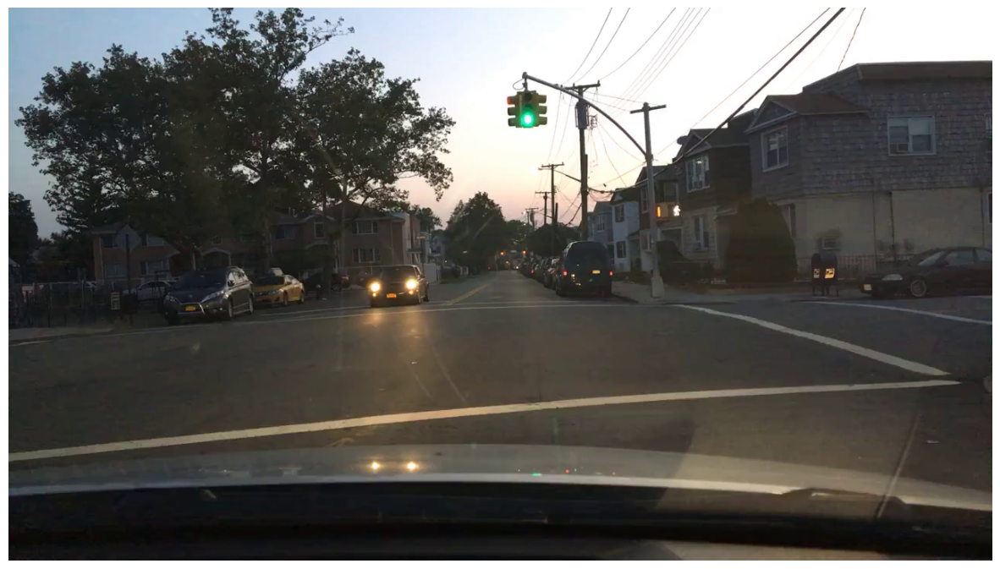

In [ ]:
display_cv2_img(img)

In [ ]:
# Giải phóng tài nguyên sau khi hoàn thành công việc với đối tượng VideoCapture
cap.release()

In [ ]:
# Tạo đối tượng VideoCapture từ video
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

# Lấy thông tin về video
frame_count = cap.get(cv2.CAP_PROP_FRAME_COUNT)
height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
fps = cap.get(cv2.CAP_PROP_FPS)

print(f'Height: {height}, Width: {width}, FPS: {fps}')

# Giải phóng tài nguyên
cap.release()




Height: 720.0, Width: 1280.0, FPS: 29.97002997002997


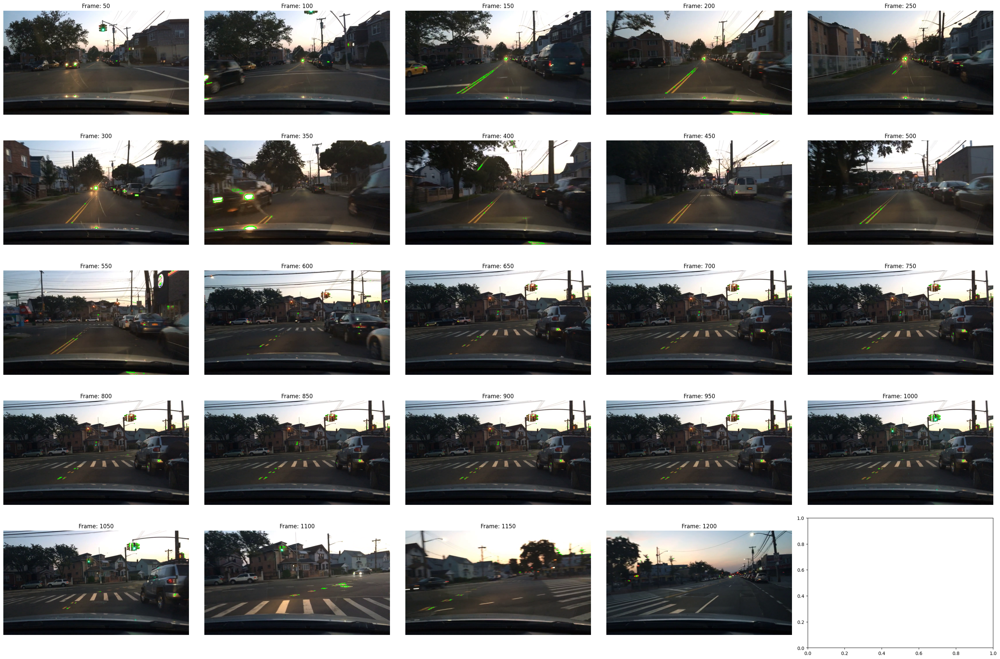

In [ ]:
# Tạo lại đối tượng VideoCapture từ video
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

# Đọc video và xử lý từng khung hình
frame_count = 0
saved_frame_count = 0
os.makedirs('frames', exist_ok=True)
fig, axs = plt.subplots(5, 5, figsize=(30, 20))
axs = axs.flatten()

# Xử lý từng khung hình trong video
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Xử lý khung hình
    processed_frame = detect_lane_lines(frame)

    # Tăng biến đếm số lượng khung hình đã hiển thị
    frame_count += 1

    # Hiển thị ảnh trong grid
    if frame_count % 50 == 0:
        frame_filename = os.path.join('frames', f'frame_{frame_count}.jpg')
        cv2.imwrite(frame_filename, processed_frame)

        axs[saved_frame_count].imshow(cv2.cvtColor(processed_frame, cv2.COLOR_BGR2RGB))
        axs[saved_frame_count].set_title(f'Frame: {frame_count}')
        axs[saved_frame_count].axis('off')
        saved_frame_count += 1

    # Lưu 50 khung hình đã hiển thị
    if saved_frame_count == 50:
        break

plt.tight_layout()
plt.show()

# Giải phóng tài nguyên
cap.release()




In [ ]:
# Đọc tệp nhãn
label = pd.read_parquet('/content/drive/MyDrive/Wimdos_ThucTap/dataset/mot_labels.parquet')
video_labels = (
    label.query('videoName == "0000f77c-cb820c98"').reset_index(drop=True).copy()
)
video_labels.shape

In [ ]:
video_labels.frameIndex.nunique()

203

In [ ]:
video_labels['videoFrame'] = (video_labels.frameIndex * 5.96).round().astype(int)
video_labels.tail()

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo,videoFrame
1385,0000f77c-cb820c98-0000203.jpg,0000f77c-cb820c98,202,00042466,car,False,True,False,651.012456,664.336680,339.938318,358.601898,True,1204
1386,0000f77c-cb820c98-0000203.jpg,0000f77c-cb820c98,202,00042467,car,False,True,False,672.177335,688.050995,335.176220,351.579001,True,1204
1387,0000f77c-cb820c98-0000203.jpg,0000f77c-cb820c98,202,00042470,car,False,True,False,685.838268,706.474025,333.877475,350.280256,True,1204
1388,0000f77c-cb820c98-0000203.jpg,0000f77c-cb820c98,202,00042471,car,False,True,False,701.904341,716.190635,332.145798,347.490336,True,1204
1389,0000f77c-cb820c98-0000203.jpg,0000f77c-cb820c98,202,00042472,car,False,True,False,897.727596,915.188621,324.208968,353.310678,True,1204


In [ ]:
video_labels.groupby('videoFrame').size().sort_values(ascending=False).head()

videoFrame
1204    14
1198    13
1192    13
1186    12
1180    12
dtype: int64

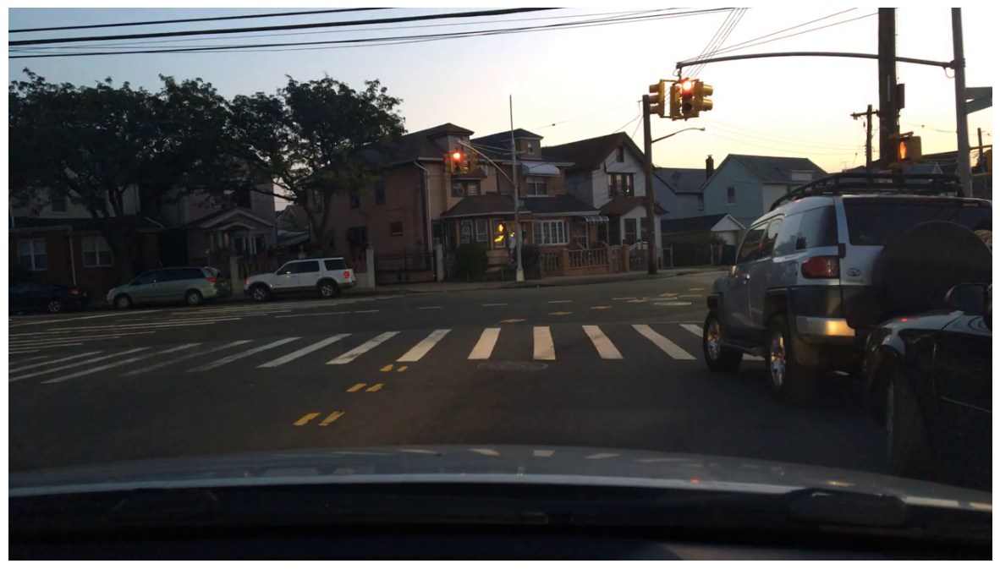

In [ ]:
# pulling frame 47
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

# n_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
get_frame = 840

for frame in range(get_frame):
    ret, img = cap.read()
    if not ret:
        break

plt.subplots(figsize=(15, 10))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off');
cap.release()

In [ ]:
img.shape

(720, 1280, 3)

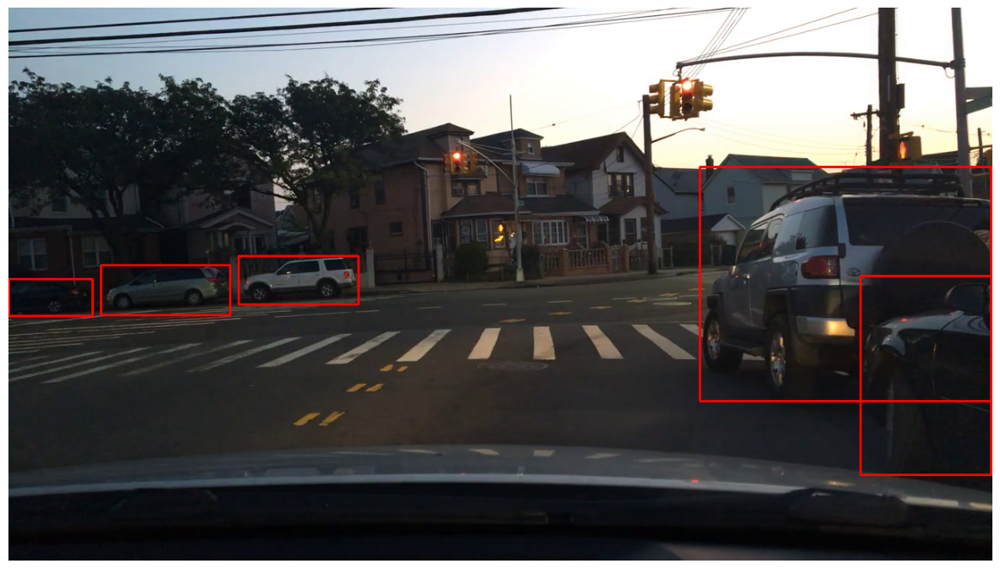

In [ ]:
frame_labels = video_labels.query('videoFrame == 840')
for i, d in frame_labels.iterrows():
    pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
    pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
    cv2.rectangle(img, pt1, pt2, (0, 0, 255), 2)

display_cv2_img(img)

In [ ]:
d

name                    0000f77c-cb820c98-0000142.jpg
videoName                           0000f77c-cb820c98
frameIndex                                        141
id                                           00042452
category                                          car
attributes.crowd                                False
attributes.occluded                             False
attributes.truncated                             True
box2d.x1                                          0.0
box2d.x2                                   109.473595
box2d.y1                                   353.891165
box2d.y2                                   401.132058
haveVideo                                        True
videoFrame                                        840
Name: 1039, dtype: object

In [ ]:
# video_labels[['category', 'id']].set_index('category').to_dict()['id']
color = video_labels.category.value_counts().to_dict()
color

{'car': 1385, 'truck': 5}

In [ ]:
color['pedestrian'] = (255, 0, 0)
color['car'] = (0, 0, 255)
color['truck'] = (0, 255, 0)
color['motorcycle'] = (0, 150, 0)
color['rider'] = (200, 0, 0)
color['bicycle'] = (0, 255, 0)
color['bus'] = (255, 0, 0)
color

{'car': (0, 0, 255),
 'truck': (0, 255, 0),
 'pedestrian': (255, 0, 0),
 'motorcycle': (0, 150, 0),
 'rider': (200, 0, 0),
 'bicycle': (0, 255, 0),
 'bus': (255, 0, 0)}

In [ ]:
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

get_frame = 840

for i in range(get_frame):
    ret, img = cap.read()
    if not ret:
        break

cap.release()

In [ ]:
video_labels.head(2)

,name,videoName,frameIndex,id,category,attributes.crowd,attributes.occluded,attributes.truncated,box2d.x1,box2d.x2,box2d.y1,box2d.y2,haveVideo,videoFrame
0,0000f77c-cb820c98-0000001.jpg,0000f77c-cb820c98,0,00042397,car,False,False,False,463.533835,547.443609,332.892549,390.587157,True,0
1,0000f77c-cb820c98-0000001.jpg,0000f77c-cb820c98,0,00042398,car,False,True,False,311.954887,385.037594,336.502727,391.127820,True,0


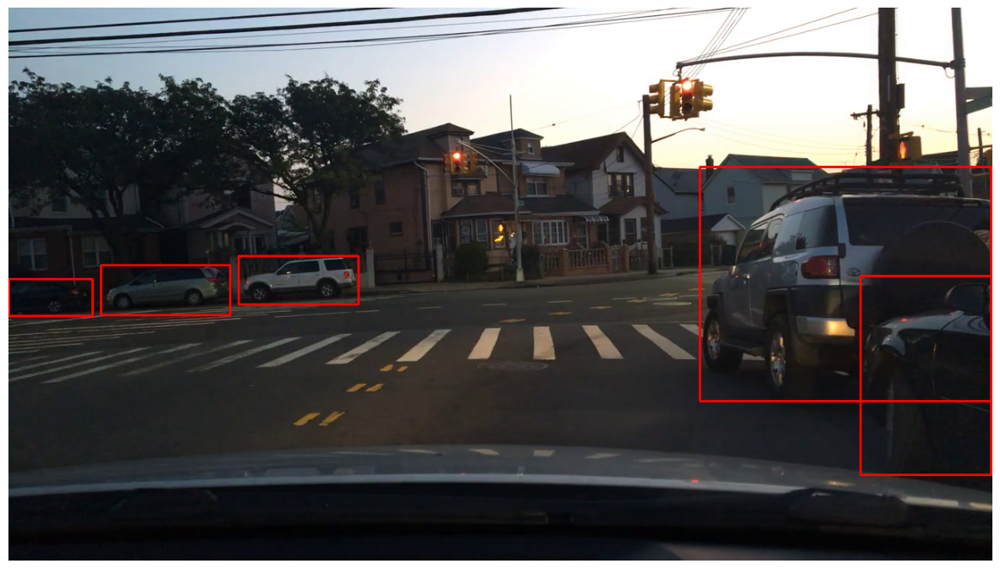

In [ ]:
frame_labels = video_labels.query('videoFrame == 840')
for i, d in frame_labels.iterrows():
    pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
    pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
    cv2.rectangle(img, pt1, pt2, color[d['category']], 2)

display_cv2_img(img)

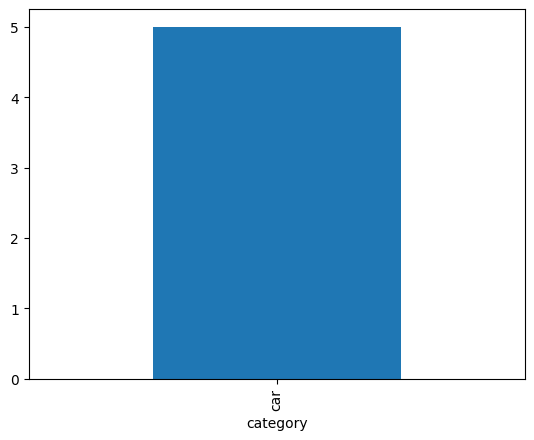

In [ ]:
frame_labels.category.value_counts().sort_values().plot(kind='bar');

In [ ]:
d

name                    0000f77c-cb820c98-0000142.jpg
videoName                           0000f77c-cb820c98
frameIndex                                        141
id                                           00042452
category                                          car
attributes.crowd                                False
attributes.occluded                             False
attributes.truncated                             True
box2d.x1                                          0.0
box2d.x2                                   109.473595
box2d.y1                                   353.891165
box2d.y2                                   401.132058
haveVideo                                        True
videoFrame                                        840
Name: 1039, dtype: object

In [ ]:
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

for i in range(get_frame):
    ret, img = cap.read()
    if not ret:
        break

cap.release()

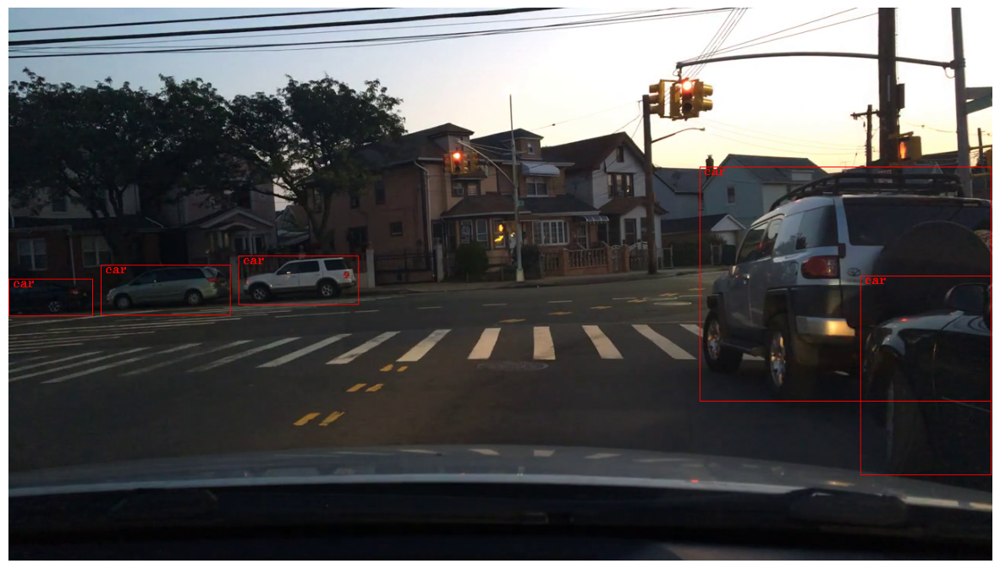

In [ ]:
img_ex = img.copy()

font = cv2.FONT_HERSHEY_TRIPLEX

for i, d in frame_labels.iterrows():
    pt1 = int(d['box2d.x1']), int(d['box2d.y1'])
    pt2 = int(d['box2d.x2']), int(d['box2d.y2'])
    cv2.rectangle(img_ex, pt1, pt2, color[d['category']])
    pt_text = int(d['box2d.x1']) + 5, int(d['box2d.y1']) + 10
    cv2.putText(img_ex, d['category'], pt_text, font, 0.5, color[d['category']])

display_cv2_img(img_ex)

In [ ]:
# Tạo lại đối tượng VideoCapture từ video
cap = cv2.VideoCapture('0000f77c-cb820c98.mp4')

# Nhận diện và vẽ vạch kẻ đường trên video
out = cv2.VideoWriter('out_test_3.mp4', cv2.VideoWriter_fourcc(*'MP4V'), fps, (int(width), int(height)))

for frame in tqdm(range(int(frame_count)), total=int(frame_count)):
    ret, img = cap.read()
    if not ret:
        break

    # Nhận diện và vẽ vạch kẻ đường
    img = detect_lane_lines(img)

    # Thêm nhãn vào khung hình
    img = add_annotation(img, frame, video_labels)

    # Ghi khung hình đã xử lý vào video đầu ra
    out.write(img)

# Giải phóng tài nguyên
cap.release()
out.release()

  0%|          | 0/1209 [00:00<?, ?it/s]

In [ ]:
# Nén video
input = 'out_test_3.mp4'
output = 'out_test_3_compressed.mp4'

subprocess.run(
    [
        'ffmpeg',
        '-i',
        input,
        '-crf',
        '18',
        '-preset',
        'veryfast',
        '-vcodec',
        'libx264',
        output,
        '-loglevel',
        'quiet'
    ]
)

# Đường dẫn đích
destination = '/content/drive/MyDrive/Wimdos_ThucTap/dataset'

# Di chuyển tệp video đến đường dẫn đích
shutil.move(output, destination)

'/content/drive/MyDrive/Wimdos_ThucTap/dataset/out_test_3_compressed.mp4'